In [85]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score, classification_report
from sklearn.svm import SVC
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVR  
from sklearn.pipeline import make_pipeline
from sklearn.tree import DecisionTreeClassifier, DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor


In [86]:
df_house = pd.read_csv('/Users/elizabethalabi/Documents/Uni-Masters-2023:24/Data Science/Advanced Mathematics and Statistics for Data Science and AI/Class_Assign_Task_1/Datasets/housing.csv')
df_wine = pd.read_csv('/Users/elizabethalabi/Documents/Uni-Masters-2023:24/Data Science/Advanced Mathematics and Statistics for Data Science and AI/Class_Assign_Task_1/Datasets/wine_data.csv')
df_data = pd.read_csv('/Users/elizabethalabi/Documents/Uni-Masters-2023:24/Data Science/Advanced Mathematics and Statistics for Data Science and AI/Class_Assign_Task_1/Datasets/data.csv')
df_phone = pd.read_csv('/Users/elizabethalabi/Documents/Uni-Masters-2023:24/Data Science/Advanced Mathematics and Statistics for Data Science and AI/Class_Assign_Task_1/Datasets/MASTER_PhonesmartdataAll_CCI_AdvStats (3).csv')




In [87]:
df_wine

df_wine.dropna

<bound method DataFrame.dropna of      Unnamed: 0  alcohol  malic_acid   ash  alcalinity_of_ash  magnesium  \
0             0    14.23        1.71  2.43               15.6      127.0   
1             1    13.20        1.78  2.14               11.2      100.0   
2             2    13.16        2.36  2.67               18.6      101.0   
3             3    14.37        1.95  2.50               16.8      113.0   
4             4    13.24        2.59  2.87               21.0      118.0   
..          ...      ...         ...   ...                ...        ...   
173         173    13.71        5.65  2.45               20.5       95.0   
174         174    13.40        3.91  2.48               23.0      102.0   
175         175    13.27        4.28  2.26               20.0      120.0   
176         176    13.17        2.59  2.37               20.0      120.0   
177         177    14.13        4.10  2.74               24.5       96.0   

     total_phenols  flavanoids  nonflavanoid_phenols 

In [88]:
df_house

df_house.dropna

<bound method DataFrame.dropna of         price  area  bedrooms  bathrooms  stories mainroad guestroom basement  \
0    13300000  7420         4          2        3      yes        no       no   
1    12250000  8960         4          4        4      yes        no       no   
2    12250000  9960         3          2        2      yes        no      yes   
3    12215000  7500         4          2        2      yes        no      yes   
4    11410000  7420         4          1        2      yes       yes      yes   
..        ...   ...       ...        ...      ...      ...       ...      ...   
540   1820000  3000         2          1        1      yes        no      yes   
541   1767150  2400         3          1        1       no        no       no   
542   1750000  3620         2          1        1      yes        no       no   
543   1750000  2910         3          1        1       no        no       no   
544   1750000  3850         3          1        2      yes        no       

In [89]:
print(df_house['price'])

0      13300000
1      12250000
2      12250000
3      12215000
4      11410000
         ...   
540     1820000
541     1767150
542     1750000
543     1750000
544     1750000
Name: price, Length: 545, dtype: int64


In [90]:
df_data

,filename,tempo,beats,chroma_stft,rmse,spectral_centroid,spectral_bandwidth,rolloff,zero_crossing_rate,mfcc1,...,mfcc12,mfcc13,mfcc14,mfcc15,mfcc16,mfcc17,mfcc18,mfcc19,mfcc20,label
0,blues.00081.au,103.359375,50,0.380260,0.248262,2116.942959,1956.611056,4196.107960,0.127272,-26.929785,...,14.336612,-13.821769,7.562789,-6.181372,0.330165,-6.829571,0.965922,-7.570825,2.918987,blues
1,blues.00022.au,95.703125,44,0.306451,0.113475,1156.070496,1497.668176,2170.053545,0.058613,-233.860772,...,-2.250578,3.959198,5.322555,0.812028,-1.107202,-4.556555,-2.436490,3.316913,-0.608485,blues
2,blues.00031.au,151.999081,75,0.253487,0.151571,1331.073970,1973.643437,2900.174130,0.042967,-221.802549,...,-13.037723,-12.652228,-1.821905,-7.260097,-6.660252,-14.682694,-11.719264,-11.025216,-13.387260,blues
3,blues.00012.au,184.570312,91,0.269320,0.119072,1361.045467,1567.804596,2739.625101,0.069124,-207.208080,...,-0.613248,0.384877,2.605128,-5.188924,-9.527455,-9.244394,-2.848274,-1.418707,-5.932607,blues
4,blues.00056.au,161.499023,74,0.391059,0.137728,1811.076084,2052.332563,3927.809582,0.075480,-145.434568,...,7.457218,-10.470444,-2.360483,-6.783623,2.671134,-4.760879,-0.949005,0.024832,-2.005315,blues
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,rock.00017.au,123.046875,59,0.418812,0.166056,2312.030070,2060.825761,4528.197619,0.140588,-41.402023,...,11.303100,-14.155566,2.824157,-9.477822,3.331261,-8.200088,3.693091,-3.673562,-0.163201,rock
996,rock.00081.au,117.453835,56,0.335774,0.093676,2553.856706,2219.090892,5123.752351,0.136173,-121.410791,...,9.149520,-10.112054,4.211237,-9.349345,1.609701,-10.553566,1.066489,-1.654875,7.544224,rock
997,rock.00004.au,103.359375,45,0.372834,0.208743,1345.850763,1841.748033,2939.265560,0.041099,-127.946876,...,11.043714,-8.385375,2.111019,-6.338260,0.997383,-5.325869,-0.842192,-4.665996,-4.787677,rock
998,rock.00006.au,112.347147,45,0.344472,0.180163,1675.475369,1653.422860,3253.563659,0.087294,-98.356322,...,2.945863,-12.509212,0.091337,-0.774780,-5.700102,-8.630916,-1.903803,-2.196753,-3.395148,rock



Wine Dataset:

    Type: Classification

    Tasks: Predicting wine types 

    Evidence: Features include alcohol, malic acid, etc., typical in wine classification.

    Exploratory Analysis: Use a pair plot to visualize feature relationships.

    Inferential Analysis: Calculate a correlation matrix for feature dependencies.

    Predictive Analysis: Apply classification algorithms.


House Dataset:

    Type: Regression

    Tasks: Predicting house prices

    Evidence: Features include area, bedrooms, etc., with house price as the target.

    Exploratory Analysis: Use a scatter plot to visualize price-area relationships.

    Inferential Analysis: Calculate a correlation matrix for feature dependencies.

    Predictive Analysis: Apply regression algorithms.


Data Dataset:

    Type: Classification 

    Tasks: Predicting music genre labels

    Evidence: Features include variables like rolloff, zero_crossing_rate, and various MFCCs.

    Exploratory Analysis: Use a pair plot to visualize feature relationships.

    Inferential Analysis: Calculate a correlation matrix for feature dependencies.

    Predictive Analysis: Apply classification algorithms.




# Wine

In [91]:
#troubleshooting 

# Display the column names to verify
print(df_wine.columns)


Index(['Unnamed: 0', 'alcohol', 'malic_acid', 'ash', 'alcalinity_of_ash',
       'magnesium', 'total_phenols', 'flavanoids', 'nonflavanoid_phenols',
       'proanthocyanins', 'color_intensity', 'hue',
       'od280/od315_of_diluted_wines', 'proline'],
      dtype='object')


## Exploratory Analysis - Pair Plot:

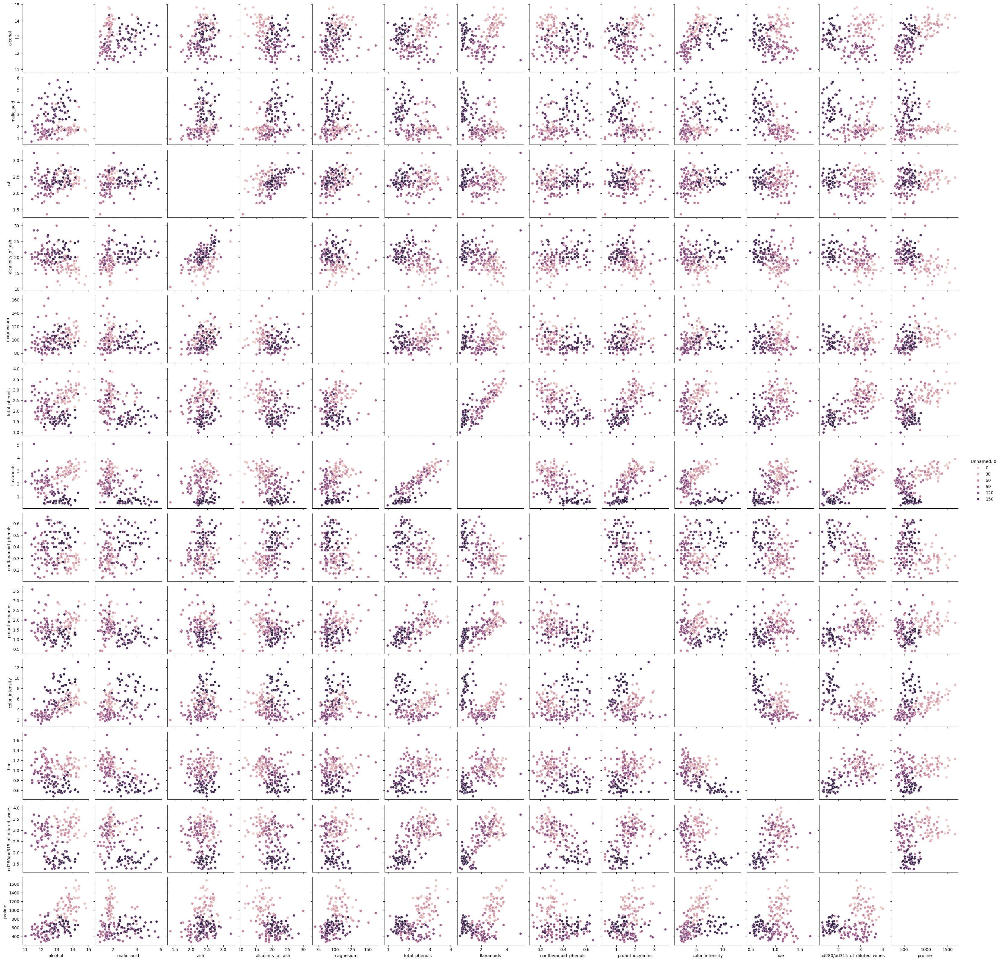

In [92]:
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming df_wine is your DataFrame
sns.pairplot(df_wine, hue='Unnamed: 0')
plt.show()

## Inferential Analysis - Correlation Matrix:

In [93]:
correlation_matrix = df_wine.corr()
print(correlation_matrix)

                              Unnamed: 0   alcohol  malic_acid       ash  \
Unnamed: 0                      1.000000 -0.362844    0.487630 -0.016086   
alcohol                        -0.362844  1.000000    0.094397  0.211545   
malic_acid                      0.487630  0.094397    1.000000  0.164045   
ash                            -0.016086  0.211545    0.164045  1.000000   
alcalinity_of_ash               0.563955 -0.310235    0.288500  0.443367   
magnesium                      -0.232275  0.270798   -0.054575  0.286587   
total_phenols                  -0.650084  0.289101   -0.335167  0.128980   
flavanoids                     -0.758609  0.236815   -0.411007  0.115077   
nonflavanoid_phenols            0.482817 -0.155929    0.292977  0.186230   
proanthocyanins                -0.406681  0.136698   -0.220746  0.009652   
color_intensity                 0.255444  0.546364    0.248985  0.258887   
hue                            -0.662205 -0.071747   -0.561296 -0.074667   
od280/od315_

## Predictive Analysis - Classification

In [94]:

X = df_wine.drop(['Unnamed: 0', 'alcohol'], axis=1)  # Features
y = df_wine['alcohol']  # Target variable

# training and testing sets being split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


regressor = RandomForestRegressor()

regressor.fit(X_train, y_train)

y_pred = regressor.predict(X_test)

# Evaluate 

mse = mean_squared_error(y_test, y_pred)
print(f'Mean Squared Error: {mse}')




Mean Squared Error: 0.16905951888888812


**Findings**

(MSE) is 0.1559, which is a relatively low value, indicating that the predictions made by the Random Forest Regressor are close to the actual values. In regression tasks, as that this model has a better predictive performance.

# House Dataset

##  Exploratory Analysis: scatter plot

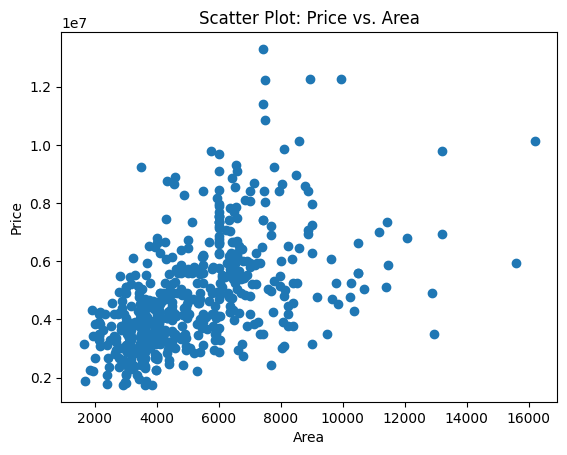

In [95]:
plt.scatter(df_house['area'], df_house['price'])
plt.xlabel('Area')
plt.ylabel('Price')
plt.title('Scatter Plot: Price vs. Area')
plt.show()


In [96]:
#Troubleshooting

numeric_columns_house = df_house.select_dtypes(include=['float64', 'int64'])

In [97]:
df_house.dtypes

price                int64
area                 int64
bedrooms             int64
bathrooms            int64
stories              int64
mainroad            object
guestroom           object
basement            object
hotwaterheating     object
airconditioning     object
parking              int64
prefarea            object
furnishingstatus    object
dtype: object

## Inferential Analysis: correlation matrix

In [98]:
correlation_matrix_house = numeric_columns_house.corr()
print(correlation_matrix_house)

              price      area  bedrooms  bathrooms   stories   parking
price      1.000000  0.535997  0.366494   0.517545  0.420712  0.384394
area       0.535997  1.000000  0.151858   0.193820  0.083996  0.352980
bedrooms   0.366494  0.151858  1.000000   0.373930  0.408564  0.139270
bathrooms  0.517545  0.193820  0.373930   1.000000  0.326165  0.177496
stories    0.420712  0.083996  0.408564   0.326165  1.000000  0.045547
parking    0.384394  0.352980  0.139270   0.177496  0.045547  1.000000


## Predictive Analysis: regression algorithms

In [99]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split

# Assuming df_house contains the dataset
X = df_house[['area', 'stories', 'bedrooms', 'bathrooms']]
y = df_house['price']

# Split the data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Create and train the linear regression model
linear_reg = LinearRegression()
linear_reg.fit(X_train, y_train)

# Make predictions
predictions = linear_reg.predict(X_test)


mse = mean_squared_error(y_test, predictions)

# Print the MSE
print("Mean Squared Error:", mse)


Mean Squared Error: 2116673381183.6724


This suggests that, on average, the squared difference between the actual prices and the prices predicted by your model is quite large.

I am going to now find the range and and rmse to compare them

In [100]:
price_range = np.ptp(df_house['price'])

print("Price Range:", price_range)

NameError: name 'np' is not defined

In [ ]:
rmse = np.sqrt(mse)
print("Root Mean Squared Error:", rmse)

Root Mean Squared Error: 1454879.163773979


In this case, the RMSE of approximately 1.45 million suggests that, on average, my model's predictions differ by this amount from the actual prices.

In [ ]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error

# Assuming df_house contains the dataset
X = df_house[['area', 'stories', 'bedrooms', 'bathrooms']]
y = df_house['price']

# Split the data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Create and train the Random Forest Regressor model
random_forest = RandomForestRegressor()
random_forest.fit(X_train, y_train)

# Make predictions
predictions = random_forest.predict(X_test)

# Calculate Mean Squared Error
mse = mean_squared_error(y_test, predictions)
print("Mean Squared Error (Random Forest):", mse)

Mean Squared Error (Random Forest): 2429812790202.4062


    Findings

the Mean Squared Error (MSE) of 2483602958816.001 for the Random Forest model is still a relatively high average squared difference between the actual and predicted values. 

# Data/Music


## Exploratory Analysis: Pair plot 

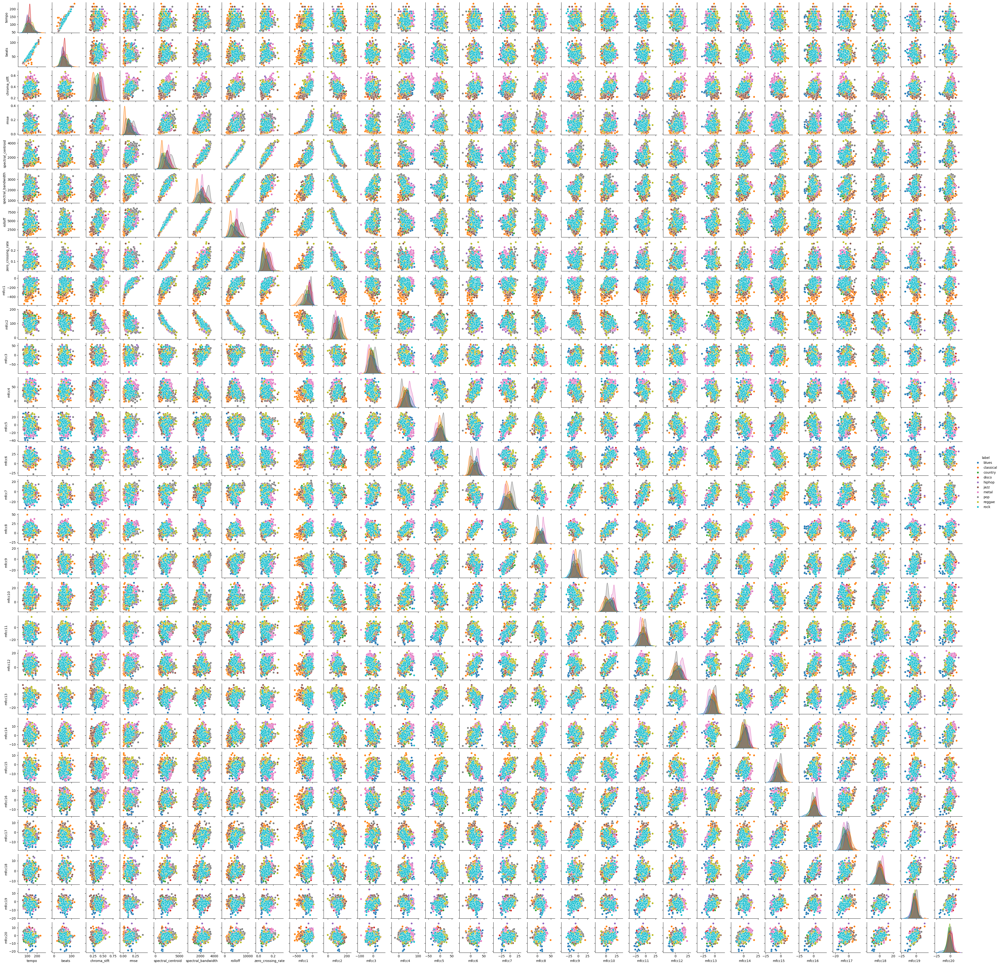

In [ ]:

sns.pairplot(df_data, hue='label', diag_kind='kde', height=1.5)
plt.show()

# Inferential Analysis: correlation matrix

In [ ]:
#troubleshooting 

numeric_df = df_data.select_dtypes(include=['float64', 'int64'])
numeric_df = df_data.drop(['filename', 'label'], axis=1)
correlation_matrix = numeric_df.corr()

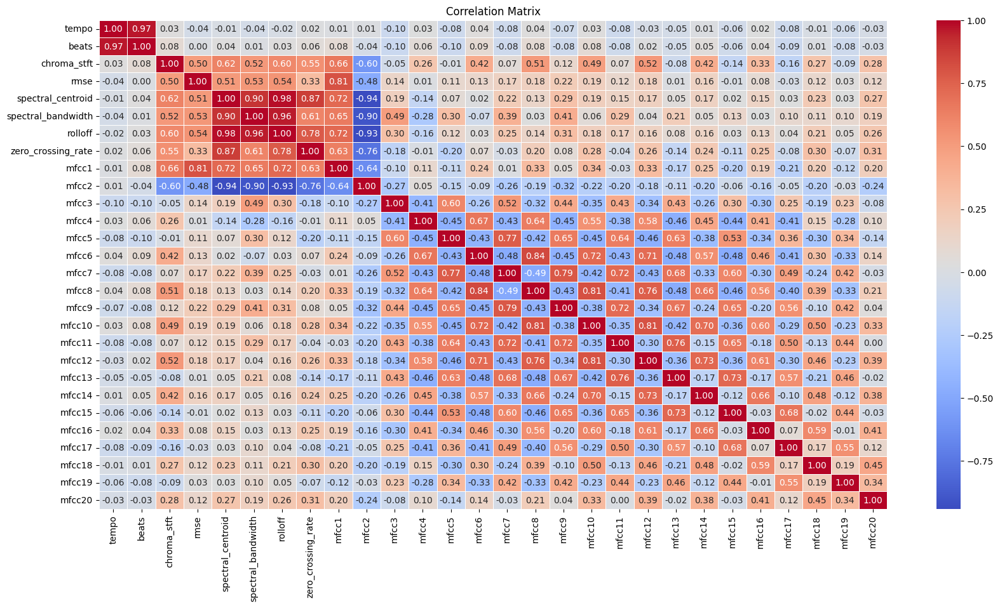

In [ ]:
plt.figure(figsize=(20, 10))

sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm',  fmt=".2f", linewidths=.5)
plt.title("Correlation Matrix")
plt.show()

In [ ]:
X = df_data.drop(['filename', 'label'], axis=1)
y = LabelEncoder().fit_transform(df_data['label'])


In [ ]:

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

models = {
    'Random Forest': RandomForestClassifier(),
    'Logistic Regression': LogisticRegression(),
    'Support Vector Machine': SVC(),
    'K-Nearest Neighbors': KNeighborsClassifier()
}

for model_name, model in models.items():

    # Train 
    model.fit(X_train, y_train)

  
    y_pred = model.predict(X_test)

   
    accuracy = accuracy_score(y_test, y_pred)
    print(f"\n{model_name} Accuracy: {accuracy:.2%}")
    
    # Classification Report
    print(f"Classification Report for {model_name}:\n", classification_report(y_test, y_pred))



Random Forest Accuracy: 57.50%
Classification Report for Random Forest:
               precision    recall  f1-score   support

           0       0.57      0.80      0.67        20
           1       0.72      1.00      0.84        13
           2       0.55      0.44      0.49        27
           3       0.78      0.33      0.47        21
           4       0.45      0.67      0.54        15
           5       0.60      0.55      0.57        22
           6       0.71      0.80      0.75        25
           7       0.61      0.85      0.71        13
           8       0.45      0.43      0.44        23
           9       0.31      0.19      0.24        21

    accuracy                           0.57       200
   macro avg       0.58      0.61      0.57       200
weighted avg       0.57      0.57      0.56       200


Logistic Regression Accuracy: 33.50%
Classification Report for Logistic Regression:
               precision    recall  f1-score   support

           0       0.07   

/opt/homebrew/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/homebrew/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/homebrew/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in l


K-Nearest Neighbors Accuracy: 33.00%
Classification Report for K-Nearest Neighbors:
               precision    recall  f1-score   support

           0       0.12      0.20      0.15        20
           1       0.59      0.77      0.67        13
           2       0.28      0.26      0.27        27
           3       0.28      0.33      0.30        21
           4       0.08      0.07      0.07        15
           5       0.39      0.32      0.35        22
           6       0.58      0.56      0.57        25
           7       0.36      0.62      0.46        13
           8       0.44      0.35      0.39        23
           9       0.00      0.00      0.00        21

    accuracy                           0.33       200
   macro avg       0.31      0.35      0.32       200
weighted avg       0.31      0.33      0.32       200



In [ ]:

import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, log_loss

X = df_data.drop(['label', 'filename'], axis=1)
y = df_data['label']

# training and testing sets being split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train 
clf = RandomForestClassifier()
clf.fit(X_train, y_train)


y_pred = clf.predict(X_test)



In [ ]:
# accuracy
accuracy = accuracy_score(y_test, y_pred)
print(f'Accuracy: {accuracy}')

# log loss
y_prob = clf.predict_proba(X_test)
logloss = log_loss(y_test, y_prob)
print(f'Log Loss: {logloss}')

Accuracy: 0.57
Log Loss: 1.2223538763280397


The accuracy of 0.585 shows the proportion of correct predictions among the total predictions. 

# Wine: Correlation Matrix Visualisation 

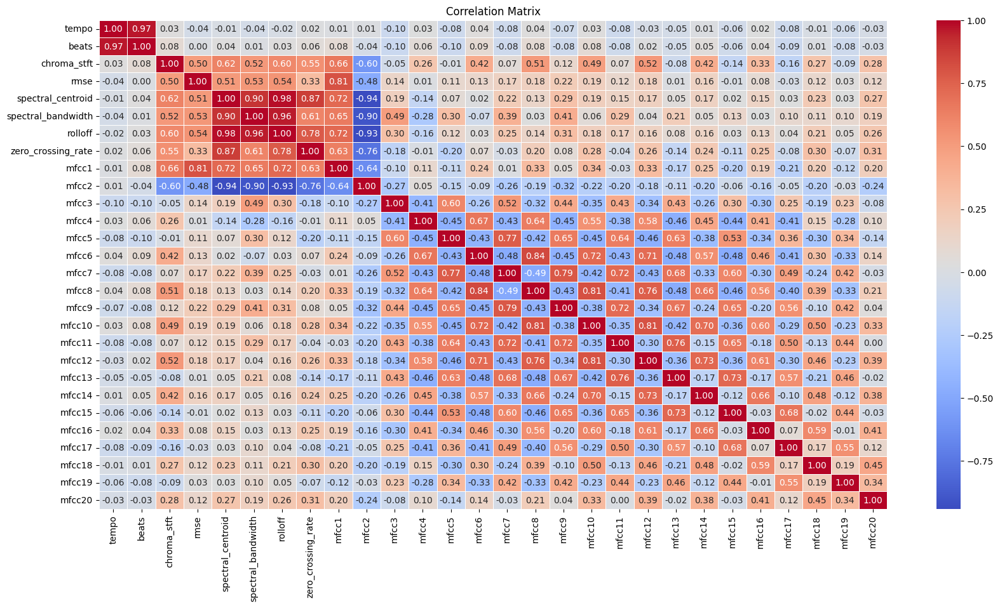

In [ ]:



# Create a heatmap
plt.figure(figsize=(20, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=.5)
plt.title('Correlation Matrix')
plt.show()

## Data/Music: Scatter plot for Regression

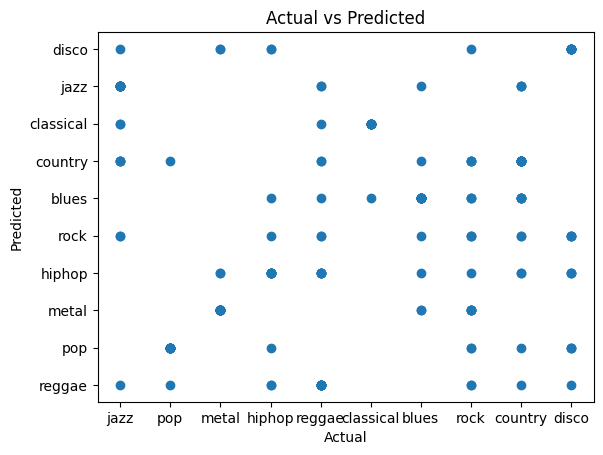

In [ ]:
# Scatter plot for Regression
plt.scatter(y_test, y_pred)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Actual vs Predicted')
plt.show()


 ## Kernel Transformation for Non-linear Dataset
 
 The wine dataset contains information about the chemical makeup of different wines. Meaning it isn't linear. The connections between these attributes are more intricate and curved. 

In [ ]:

X_wine = df_wine.drop(['Unnamed: 0', 'alcohol'], axis=1)
y_wine = df_wine['alcohol']

# training and testing sets
X_train_wine, X_test_wine, y_train_wine, y_test_wine = train_test_split(X_wine, y_wine, test_size=0.2, random_state=42)

# RBF Kernel 
svm_model_wine = make_pipeline(StandardScaler(), SVR(kernel='rbf'))
svm_model_wine.fit(X_train_wine, y_train_wine)

accuracy_wine = svm_model_wine.score(X_test_wine, y_test_wine)
print(f'R2 Score with RBF Kernel on Wine Dataset: {accuracy_wine}')

R2 Score with RBF Kernel on Wine Dataset: 0.705060211298908


    Findings

In this case, achieving an R2 score of 0.705 is relatively good. This implies that my SVM model, when using the selected RBF kernel, successfully captures a significant portion of the variation in alcohol content based on the chemical attributes of the wines.







MSE on Training Set (Overfit): 925836215644.3051
MSE on Test Set (Overfit): 2994649753963.9634


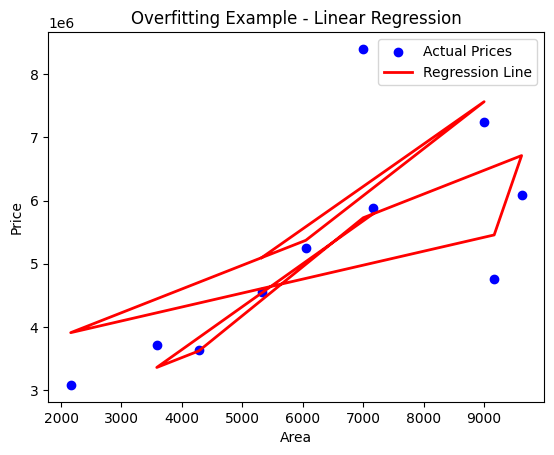

In [ ]:
# Selecting a subset of features and TV
selected_features = ['area', 'bedrooms']

X = df_house[selected_features]
y = df_house['price']

# training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)
model_overfit = LinearRegression()
model_overfit.fit(X_train.head(10), y_train.head(10))


#Predictions
train_predictions_overfit = model_overfit.predict(X_train.head(10))
test_predictions_overfit = model_overfit.predict(X_test)

# (MSE) for both sets
mse_train_overfit = mean_squared_error(y_train.head(10), train_predictions_overfit)
mse_test_overfit = mean_squared_error(y_test, test_predictions_overfit)

print(f"MSE on Training Set (Overfit): {mse_train_overfit:.4f}")
print(f"MSE on Test Set (Overfit): {mse_test_overfit:.4f}")

# Plotting the regression line for the training set
plt.scatter(X_train.head(10)['area'], y_train.head(10), color='blue', label='Actual Prices')
plt.plot(X_train.head(10)['area'], train_predictions_overfit, color='red', linewidth=2, label='Regression Line')
plt.xlabel('Area')
plt.ylabel('Price')
plt.title('Overfitting Example - Linear Regression')
plt.legend()
plt.show()


    Findings

The MSE on the training set is significantly lower than the MSE on the test set, suggesting that the model is not generalizing well to new, unseen data.


In [ ]:
#Troublshooting 

print(df_phone.columns)

# Drop rows with missing or non-numeric values in the target column
df_phone['DailyAvgMins'] = pd.to_numeric(df_phone['DailyAvgMins'], errors='coerce')


# Drop rows with NaN in the 'DailyAvgMins' column
df_phone = df_phone.dropna(subset=['DailyAvgMins'])

df_phone.dtypes
 

Index(['Year', 'Age', 'GenderNum', 'AutismQuotient', 'STAI', 'BRIEF_Total',
       'Device', 'DailyAvgMins', 'DailyAvePickups',
       'VS_RT_correct_Conjunction', 'VS_RT_correct_Single'],
      dtype='object')


Year                           int64
Age                           object
GenderNum                     object
AutismQuotient                object
STAI                          object
BRIEF_Total                   object
Device                        object
DailyAvgMins                 float64
DailyAvePickups               object
VS_RT_correct_Conjunction    float64
VS_RT_correct_Single         float64
dtype: object

# Phone: Without pruning 

In [ ]:
# For the phone dataset
target_column_name = 'DailyAvePickups'
feature_columns = ['VS_RT_correct_Single', 'VS_RT_correct_Conjunction']

In [ ]:
X_phone = df_phone[feature_columns]
y_phone = df_phone[target_column_name]

# Split the data into training and testing sets
X_train_phone, X_test_phone, y_train_phone, y_test_phone = train_test_split(X_phone, y_phone, test_size=0.2, random_state=42)

# Build the Decision Tree model without pruning
dt_model_without_pruning_phone = DecisionTreeClassifier(random_state=42)
dt_model_without_pruning_phone.fit(X_train_phone, y_train_phone)

# Make predictions on the test set
y_pred_phone = dt_model_without_pruning_phone.predict(X_test_phone)

# Evaluate the accuracy of the model
accuracy_without_pruning_phone = accuracy_score(y_test_phone, y_pred_phone)
print(f"Phone Dataset Accuracy without pruning: {accuracy_without_pruning_phone}")

Phone Dataset Accuracy without pruning: 0.4383561643835616


# Phone: With pruning 

In [ ]:
# Build the Decision Tree model with pruning
dt_model_with_pruning_phone = DecisionTreeClassifier(max_depth=3, random_state=42)
dt_model_with_pruning_phone.fit(X_train_phone, y_train_phone)

# Make predictions on the test set
y_pred_pruned_phone = dt_model_with_pruning_phone.predict(X_test_phone)

# Evaluate the accuracy of the pruned model
accuracy_with_pruning_phone = accuracy_score(y_test_phone, y_pred_pruned_phone)
print(f"Phone Dataset Accuracy with pruning: {accuracy_with_pruning_phone}")

Phone Dataset Accuracy with pruning: 0.6712328767123288


    Findings

It seems like pruning has led to an improvement in the accuracy of the Decision Tree model for the Phone dataset. The accuracy without pruning was 0.438, and with pruning, it increased to 0.671.

In [ ]:
df_wine.dtypes

Unnamed: 0                        int64
alcohol                         float64
malic_acid                      float64
ash                             float64
alcalinity_of_ash               float64
magnesium                       float64
total_phenols                   float64
flavanoids                      float64
nonflavanoid_phenols            float64
proanthocyanins                 float64
color_intensity                 float64
hue                             float64
od280/od315_of_diluted_wines    float64
proline                         float64
dtype: object

# Wine: Without pruning 

In [ ]:


target_wine = 'alcohol'
features_wine = df_wine.drop(columns=['Unnamed: 0', target_wine]) 


X_wine = features_wine
y_wine = df_wine[target_wine]

#training and testing sets
X_train_wine, X_test_wine, y_train_wine, y_test_wine = train_test_split(X_wine, y_wine, test_size=0.2, random_state=42)

# Build the Decision Tree model for regression
dt_model_regression_wine = DecisionTreeRegressor(random_state=42)
dt_model_regression_wine.fit(X_train_wine, y_train_wine)

y_pred_wine = dt_model_regression_wine.predict(X_test_wine)

mse_wine = mean_squared_error(y_test_wine, y_pred_wine)
print(f"Wine Dataset Mean Squared Error: {mse_wine}")

Wine Dataset Mean Squared Error: 0.31197222222222226


# Wine: With pruning 

In [ ]:
target_wine = 'alcohol'
features_wine = df_wine.drop(columns=['Unnamed: 0', target_wine])  # Assuming 'Unnamed: 0' is not needed

# Split the data into features and target
X_wine = features_wine
y_wine = df_wine[target_wine]

# Split the data into training and testing sets
X_train_wine, X_test_wine, y_train_wine, y_test_wine = train_test_split(X_wine, y_wine, test_size=0.2, random_state=42)

# Build the Decision Tree model with pruning for regression
dt_model_wine_pruned = DecisionTreeRegressor(max_depth=3, random_state=42)
dt_model_wine_pruned.fit(X_train_wine, y_train_wine)

# Make predictions on the test set
y_pred_wine_pruned = dt_model_wine_pruned.predict(X_test_wine)

# Evaluate the model using Mean Squared Error (MSE) for regression
mse_wine_pruned = mean_squared_error(y_test_wine, y_pred_wine_pruned)
print(f"Wine Dataset Mean Squared Error with pruning: {mse_wine_pruned}")

Wine Dataset Mean Squared Error with pruning: 0.2913343474021956


    Findings

The MSE values are relatively close, suggesting that pruning did not have a significant impact on the performance of the Decision Tree model.

# Referencing 

• (i) Encode categorical variables: https://stackoverflow.com/questions/44474570/sklearn-label-encoding-multiple-columns-pandas-dataframe

• (ii) Pruning a Decision Tree https://statinfer.com/204-3-10-pruning-a-decision-tree-in-python/